# Context of the problem

Cintas is a company that delivers clean uniforms to customers around the city.  While GPS can help navigate routes in real-time, route planning is done in advance based on sequencing stops based on geographical considerations. In fact, after speaking with a representative, I found that they plan routes entirely on zipcodes. The zipcode of a series of stops is not always the greatest predictor of what will complete the series of stops in the least amount of time. Can we predict traffic issues before they occur so that we may avoid them?

We will explore the Real-Time Traffic Incident Reports from Austin's Open Data Portal.
(https://data.austintexas.gov/Transportation-and-Mobility/Real-Time-Traffic-Incident-Reports/dx9v-zd7x)

# Steps Taken

1. Latitude and Longitude now both float data types

2. Null values removed with little impact on number of rows

3. Traffic Report ID, Status columns removed

4. Scope of coordinates slightly reduced for a more realistic representation of the city

5. The issue_timespan column was engineered (in minutes) and the status_date column was dropped

6. Issues with negative resolution times or times beyond 24 hours were removed

7. The number of classes in the issue_reported column was reduced from 23 to 8 through either combining similar labels or dropping the class entirely due to a lack of instances.

# Import necessary libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from numpy.random import seed
import plotly.express as px
import descartes
import geopandas as gpd
from shapely.geometry import Point, Polygon

%matplotlib inline


In [2]:
df = pd.read_csv('traffic_eda_pt1.csv', index_col=0)
df.head()

,published_date,issue_reported,Location,Latitude,Longitude,Address,issue_timespan
0,2018-06-13 06:35:59+00:00,Crash Service,"(30.283797,-97.741906)",30.283797,-97.741906,W 21ST ST & GUADALUPE ST,144.066667
1,2018-06-13 10:15:36+00:00,Traffic Hazard,"(30.339593,-97.700963)",30.339593,-97.700963,400-717 E ANDERSON LN EB,64.450000
2,2020-04-17 21:25:03+00:00,Crash Service,"(30.329455,-97.638105)",30.329455,-97.638105,E US 290 HWY SVRD EB & EASTERN HEIGHTS BLVD,30.000000
3,2020-04-17 21:40:52+00:00,Traffic Hazard,"(30.202806,-97.760701)",30.202806,-97.760701,5300-blk S Ih 35 Sb,14.183333
4,2020-04-17 21:00:55+00:00,Crash Service,"(30.184265,-97.687339)",30.184265,-97.687339,4500-4720 S Us 183 Hwy Sb,149.150000


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 245137 entries, 0 to 249649
Data columns (total 7 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   published_date  245137 non-null  object 
 1   issue_reported  245137 non-null  object 
 2   Location        245137 non-null  object 
 3   Latitude        245137 non-null  float64
 4   Longitude       245137 non-null  float64
 5   Address         245137 non-null  object 
 6   issue_timespan  245137 non-null  float64
dtypes: float64(3), object(4)
memory usage: 15.0+ MB


# A Closer Look at Addresses

Adresses are not as percise a measure as coordinates

In [4]:
df.Address.value_counts()

E Parmer Ln & Dessau Rd                  174
9300 S Ih 35 Svrd Sb                     159
E Riverside Dr & S Pleasant Valley Rd    155
Fm 969 Rd & N Fm 973 Rd                  150
Dessau Rd & E Parmer Ln                  148
                                        ... 
3412-3416 W William Cannon Dr              1
718 E 7th St                               1
712 E 32ND ST                              1
1603 Strickland Dr                         1
17913 Civorno Dr                           1
Name: Address, Length: 81542, dtype: int64

There are 81,542 addresses for 245,137 incidents. Plus we can see that there are addresses with only 1 incident. Let's look at some of the more high volume addresses. This data span over 5 years. Let's see how many addresses have more than 10 a year.

In [5]:

highvol = df[df.groupby("Address")['Address'].transform('size') > 100]
highvol

,published_date,issue_reported,Location,Latitude,Longitude,Address,issue_timespan
17,2020-04-24 11:30:54+00:00,Crash Service,"(30.173724,-97.823807)",30.173724,-97.823807,W Slaughter Ln & Menchaca Rd,89.183333
22,2020-04-24 11:31:18+00:00,Traffic Hazard,"(30.173724,-97.823807)",30.173724,-97.823807,W Slaughter Ln & Menchaca Rd,8.766667
58,2020-06-19 12:22:30+00:00,Traffic Hazard,"(30.36314,-97.697022)",30.363140,-97.697022,N Lamar Blvd & W Rundberg Ln,17.566667
316,2020-08-25 17:16:05+00:00,Crash Service,"(30.3579,-97.687501)",30.357900,-97.687501,N Ih 35 Svrd Nb & E Rundberg Ln,8.966667
319,2020-08-25 17:16:19+00:00,Crash Service,"(30.381932,-97.686374)",30.381932,-97.686374,W Braker Ln & N Lamar Blvd,133.750000
...,...,...,...,...,...,...,...
249482,2021-12-12 14:44:38+00:00,Traffic Hazard,"(30.443859,-97.742349)",30.443859,-97.742349,W Parmer Ln & Mc Neil Dr,40.416667
249524,2021-12-12 19:38:32+00:00,Traffic Hazard,"(30.407827,-97.67823)",30.407827,-97.678230,W Parmer Ln & N Lamar Blvd,46.516667
249587,2021-12-13 04:30:57+00:00,Traffic Hazard,"(30.234103,-97.722846)",30.234103,-97.722846,E Riverside Dr & S Pleasant Valley Rd,24.100000
249610,2021-12-13 14:41:14+00:00,COLLISION,"(30.256997,-97.611818)",30.256997,-97.611818,Fm 969 Rd & N Fm 973 Rd,8.816667


# Relationship Between High Volume Address and Timespan?

Text(0.5, 1.0, 'Time Taken to Resolve Issue in Minutes Sorted by High Volume Addresses')

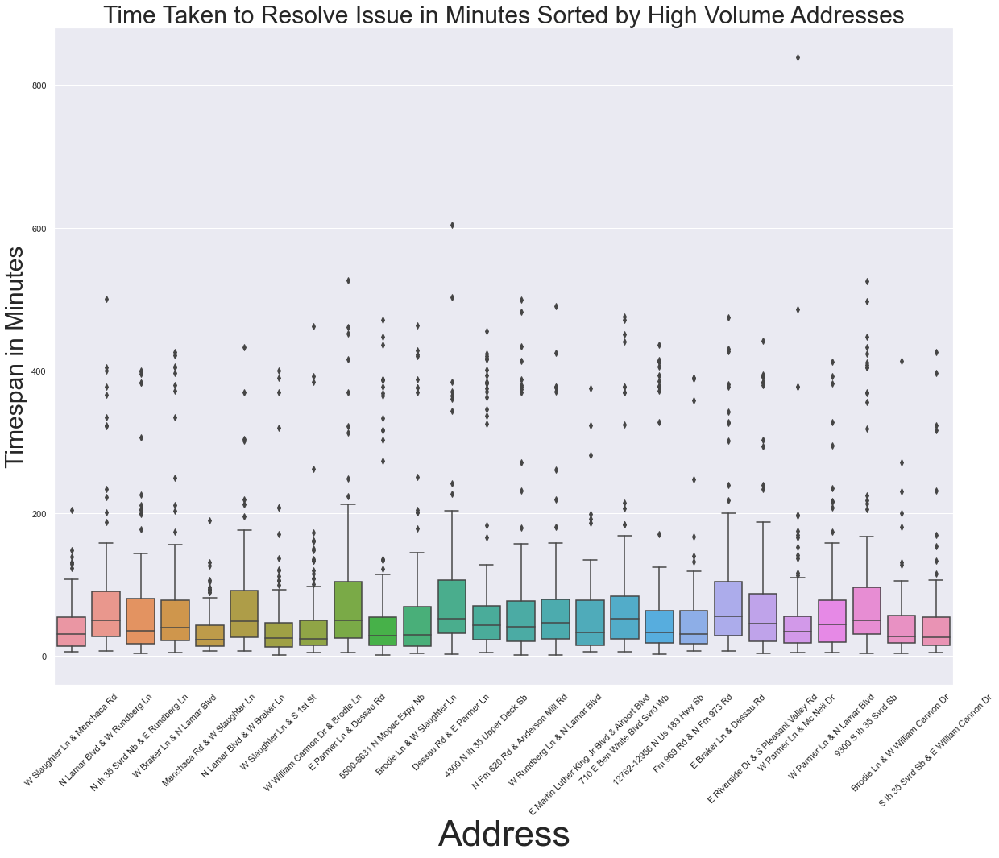

In [7]:
ax = sns.boxplot(x= 'Address', y='issue_timespan', data=highvol)
plt.xlabel('Address' , fontsize=45)
ax.set_xticklabels(ax.get_xticklabels(),rotation=45)
plt.ylabel('Timespan in Minutes', fontsize=30)
sns.set(rc={'figure.figsize':(20,15)})
plt.title('Time Taken to Resolve Issue in Minutes Sorted by High Volume Addresses', fontsize=30)

# Correlation Between Address and Coordinates

I see that some addresses have incidents that take longer than others. Perhaps we can use the coordinates to find a correlation.

In [8]:
highvol = df[df.groupby(["Latitude", "Longitude"])['Latitude'].transform('size') > 100]
highvol 

,published_date,issue_reported,Location,Latitude,Longitude,Address,issue_timespan
14,2020-04-19 00:37:41+00:00,Stalled Vehicle,"(30.234061,-97.864779)",30.234061,-97.864779,W Us 290 Hwy & W William Cannon Dr,62.383333
17,2020-04-24 11:30:54+00:00,Crash Service,"(30.173724,-97.823807)",30.173724,-97.823807,W Slaughter Ln & Menchaca Rd,89.183333
22,2020-04-24 11:31:18+00:00,Traffic Hazard,"(30.173724,-97.823807)",30.173724,-97.823807,W Slaughter Ln & Menchaca Rd,8.766667
28,2020-04-29 09:59:01+00:00,Traffic Hazard,"(30.288534,-97.752769)",30.288534,-97.752769,N Lamar Blvd & W 24th St,11.033333
38,2020-04-17 23:40:47+00:00,Crash Service,"(30.419407,-97.660947)",30.419407,-97.660947,W Howard Ln & Mc Callen Pass,9.300000
...,...,...,...,...,...,...,...
249624,2021-12-13 16:00:07+00:00,Traffic Hazard,"(30.455919,-97.659926)",30.455919,-97.659926,CENTRAL COMMERCE DR & GRAND AVENUE PKWY,9.916667
249626,2021-12-13 16:30:52+00:00,Traffic Hazard,"(30.377284,-97.658729)",30.377284,-97.658729,E Braker Ln & Dessau Rd,9.183333
249631,2021-12-13 17:45:53+00:00,Traffic Hazard,"(30.260873,-97.758521)",30.260873,-97.758521,S Lamar Blvd & Barton Springs Rd,19.150000
249633,2021-12-13 17:48:53+00:00,Traffic Hazard,"(30.256997,-97.611818)",30.256997,-97.611818,FM 969 RD & N FM 973 RD,31.166667


In [9]:
highvol.Location.value_counts()

(30.256997,-97.611818)    389
(30.387004,-97.648592)    379
(30.173724,-97.823807)    370
(30.164182,-97.692911)    344
(30.349292,-97.538573)    302
                         ... 
(30.288534,-97.752769)    102
(30.406595,-97.852479)    102
(30.167197,-97.790934)    102
(30.35895,-97.689619)     101
(30.426793,-97.676683)    101
Name: Location, Length: 133, dtype: int64

Using a filter to examine only those addresses that occur over 100 times, we see there are 3283 instances. Using the same technique on the coordinates columns finds 20,729 instances. Additionally, high volume coordinates occur much more often than high volume addresses. This may indicate that the Address columns may not be the most reliable. Let's drop it. Also, we will stick with our numerical coordinates and drop Location.

In [10]:
df.drop(['Address'], axis=1, inplace=True)
df.drop(['Location'], axis=1, inplace=True)
df.head(3)

,published_date,issue_reported,Latitude,Longitude,issue_timespan
0,2018-06-13 06:35:59+00:00,Crash Service,30.283797,-97.741906,144.066667
1,2018-06-13 10:15:36+00:00,Traffic Hazard,30.339593,-97.700963,64.450000
2,2020-04-17 21:25:03+00:00,Crash Service,30.329455,-97.638105,30.000000


# Is there a correlation between coordinates and timespan?

In [11]:
df.corr(method ='pearson')

,Latitude,Longitude,issue_timespan
Latitude,1.000000,0.078065,0.009235
Longitude,0.078065,1.000000,0.004761
issue_timespan,0.009235,0.004761,1.000000


## Visualizing with Geopandas

First we have to create a geometry column

In [12]:
crs = {'init': 'epsg:4326'}

In [13]:
geometry = [Point(xy) for xy in zip(df['Longitude'], df['Latitude'])]
geometry[:3]

In [14]:
geo_df = gpd.GeoDataFrame(df,
                         crs = crs,
                         geometry = geometry)
geo_df.head()

/Users/tshields/opt/anaconda3/envs/Springboard/lib/python3.8/site-packages/pyproj/crs/crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


,published_date,issue_reported,Latitude,Longitude,issue_timespan,geometry
0,2018-06-13 06:35:59+00:00,Crash Service,30.283797,-97.741906,144.066667,POINT (-97.74191 30.28380)
1,2018-06-13 10:15:36+00:00,Traffic Hazard,30.339593,-97.700963,64.450000,POINT (-97.70096 30.33959)
2,2020-04-17 21:25:03+00:00,Crash Service,30.329455,-97.638105,30.000000,POINT (-97.63810 30.32945)
3,2020-04-17 21:40:52+00:00,Traffic Hazard,30.202806,-97.760701,14.183333,POINT (-97.76070 30.20281)
4,2020-04-17 21:00:55+00:00,Crash Service,30.184265,-97.687339,149.150000,POINT (-97.68734 30.18426)


In [15]:
mapbox_access_token =  'pk.eyJ1IjoidG9tc2hpZWxkczcxIiwiYSI6ImNreXl0anNxajBjaXQybnJtdW5zeXdqb3UifQ.6vXBOrDTeliFVziQaB6ecg'
px.set_mapbox_access_token(mapbox_access_token)
fig = px.scatter_mapbox(geo_df, lat="Latitude", lon="Longitude", color ='issue_timespan', zoom=8
#                        #mapbox tokens found here https://account.mapbox.com/access-tokens
                      )
fig.show()

### It doesn't look like there is a correlation between coordinates and issue timespan.

## Is there a coorelation between coordinates and the issue class?

Text(2527.4715624999994, 0.5, 'Latitude')

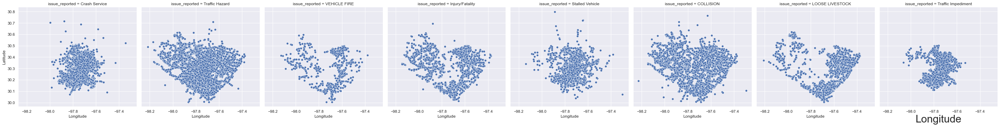

In [16]:
ax = sns.relplot(x='Longitude',y='Latitude', data=df, kind='scatter', col='issue_reported')
plt.xlabel('Longitude', fontsize=30)
plt.ylabel('Latitude', fontsize=30)

Traffic hazards and collisions seems evenly distributed throughout the city. Other categories either cluster or are oddly absent from sections of the city.

There is a distinct lack of collision with injury in the center of town. This could be due to the reduced speeds that occur in that region.


Loose livestock and appears to be clustered around the eastern part of the city. This makes sense as there are not may suburbs on teh east side and the landscape turn from urban to rural quite quickly. 


Conversely, stalled vehicle and traffic impediment seem to be a much larger issue the the central part of the city. This could be due to the lack of lanes in the city central, providing little room to go around stalled vehicles and other large objects.

In [17]:
mapbox_access_token =  'pk.eyJ1IjoidG9tc2hpZWxkczcxIiwiYSI6ImNreXl0anNxajBjaXQybnJtdW5zeXdqb3UifQ.6vXBOrDTeliFVziQaB6ecg'
px.set_mapbox_access_token(mapbox_access_token)
fig = px.scatter_mapbox(geo_df, lat="Latitude", lon="Longitude", color ='issue_reported', zoom=8
#                        #mapbox tokens found here https://account.mapbox.com/access-tokens
                      )
fig.show()

This visualization backs up some previous conlcusions. 

Loose livestock much more prevelant on the east side of town than any other issue.

Stalled Vehicle and traffic hazards appears to be most prevalent in the central part of the city compared to the outskirts.

Injury and fataltiy rarely occur in the city center. 

# How do we approach the variance of issue_timespan?

What to do with issue_reported times? They vary by a large margin.

Since I am looking to produce a realistic time value for how long an incident took to resolve, or remove an obstacle from traffic, I need to come up with a time limit that makes sense.

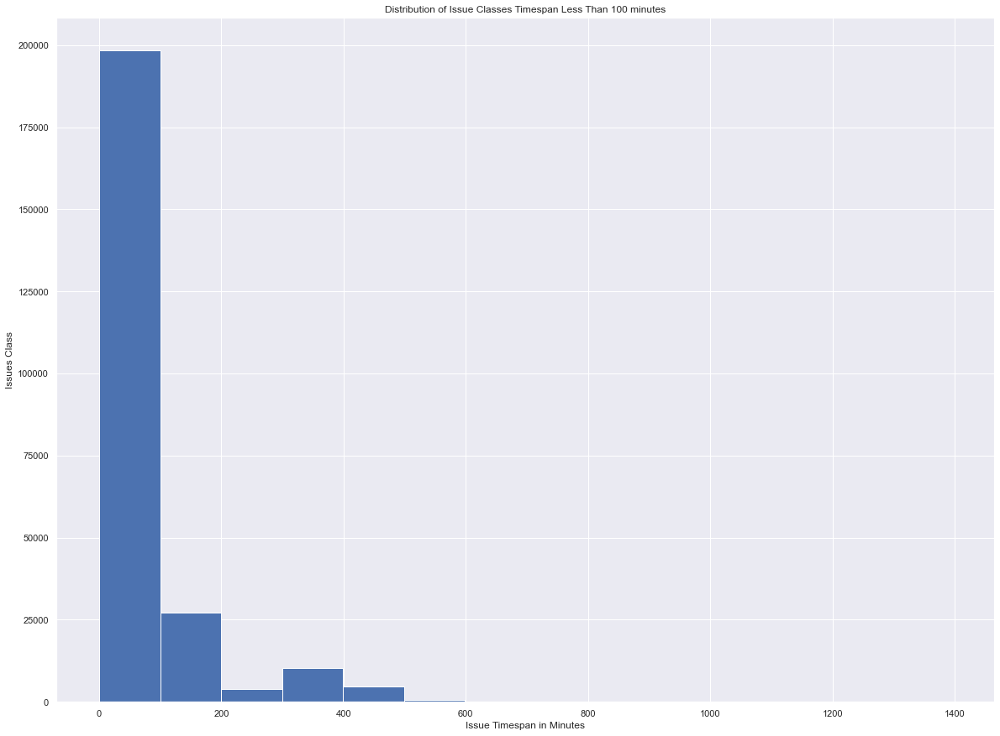

In [18]:
df.issue_timespan[df.issue_timespan < 1440].hist(bins=14)
plt.xlabel('Issue Timespan in Minutes')
plt.ylabel('Issues Class')
plt.title('Distribution of Issue Classes Timespan Less Than 100 minutes');

The plot above shows the average timespan of a given issue in minutes of a full day, where I made my previous limit. It looks like it should be narrowed down further. It appears that there is a jump at 500 minutes.

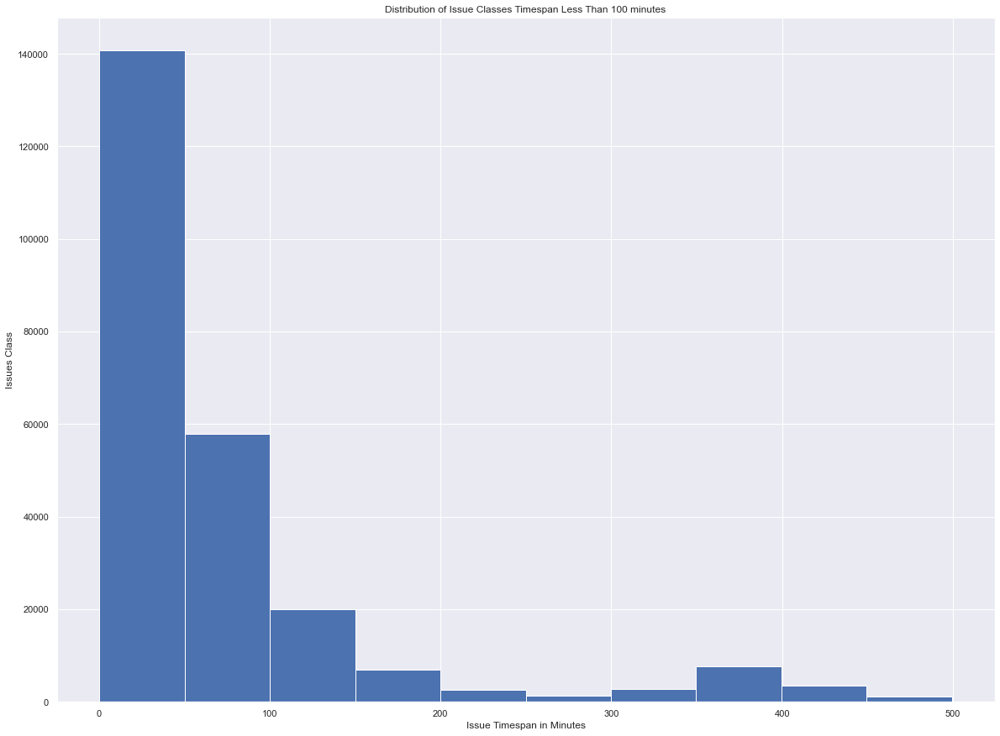

In [19]:
df.issue_timespan[df.issue_timespan < 500].hist(bins=10)
plt.xlabel('Issue Timespan in Minutes')
plt.ylabel('Issues Class')
plt.title('Distribution of Issue Classes Timespan Less Than 100 minutes');

We can at least see all the bins involved at 500 minutes. Still the vast majority of instances have a timespan of less than 200 minutes. Still, cutting that many rows would degrade our dataset significantly. Let's round down to 480 minutes, bring the total to the equivalent to 8 hours.

In [20]:
df = df[df.issue_timespan <= 480]
df.issue_timespan.max()

480.0

## Another look at issue_reported with the new time limit

Text(0.5, 1.0, 'Time Taken to Resolve Issue Measured in Minutes')

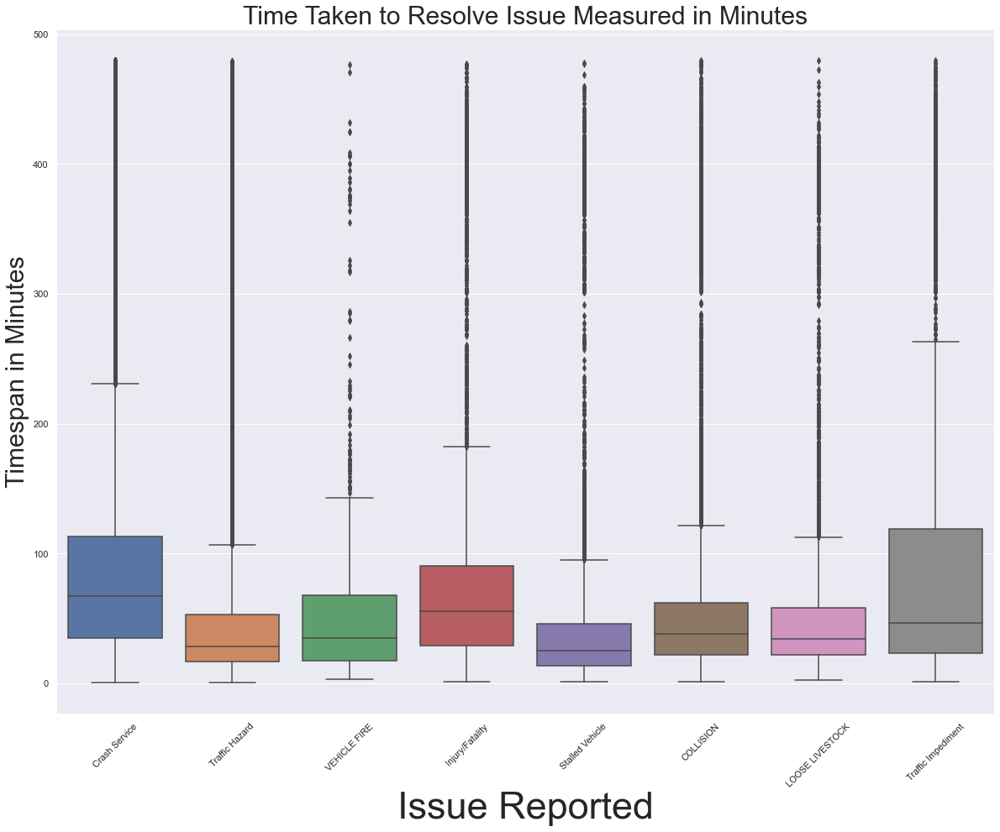

In [21]:
ax = sns.boxplot(x= 'issue_reported', y='issue_timespan', data=df)
plt.xlabel('Issue Reported' , fontsize=45)
ax.set_xticklabels(ax.get_xticklabels(),rotation=45)
plt.ylabel('Timespan in Minutes', fontsize=30)
sns.set(rc={'figure.figsize':(20,15)})
plt.title('Time Taken to Resolve Issue Measured in Minutes', fontsize=30)

This visualization gives us a better understanding of how long issues take to resolve.

Traffic hazards and stalled vehicles, which as we saw above happen most often in the city center, get resolved quickly. This makes sense as services are often centrally located and there is more urgency involved the more traffic there is.

In contrast, injury and fatality rarely happen in the city center, possibly due to the speeds necessary to cause harm and death are hard to reach in this part of the city.

Crash service and traffic impediment have the longest wait times, presumably because a team of professionals are needed to clear the road when these issues arise. They are followed up closely injury/fatality which we can assume has to do with the time it takes for medical professionals to arrive and perform their duties before vehicles can be repositioned. 





In [22]:
df.shape

(244175, 6)

In [23]:
df.to_csv('traffic_eda_pt2.csv') 